In [1]:
!nvidia-smi

Wed Jun 26 23:40:33 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/kaggle/working


In [3]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 5689.3/8062.4 GB disk)


In [4]:
from ultralytics import YOLO

from IPython.display import display, Image

In [5]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8s.pt data='/kaggle/input/super-new/data.yaml' epochs=100 imgsz=640 plots=True

/kaggle/working
100%|███████████████████████████████████████| 21.5M/21.5M [00:00<00:00, 149MB/s]
New https://pypi.org/project/ultralytics/8.2.45 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/kaggle/input/super-new/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show

/kaggle/working


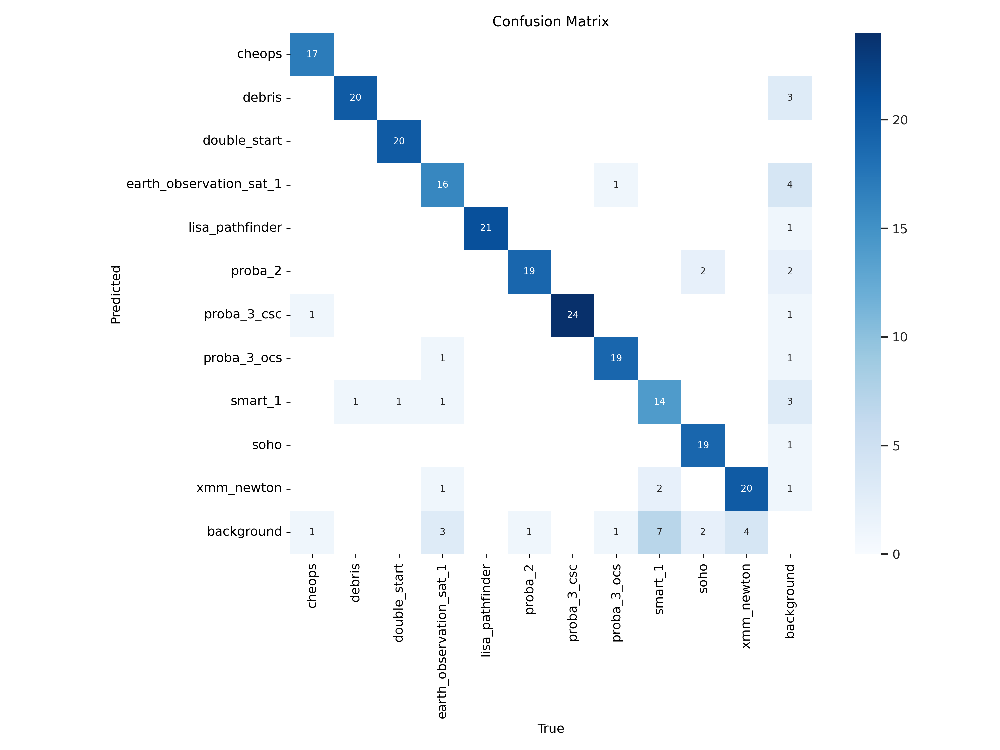

In [6]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

/kaggle/working


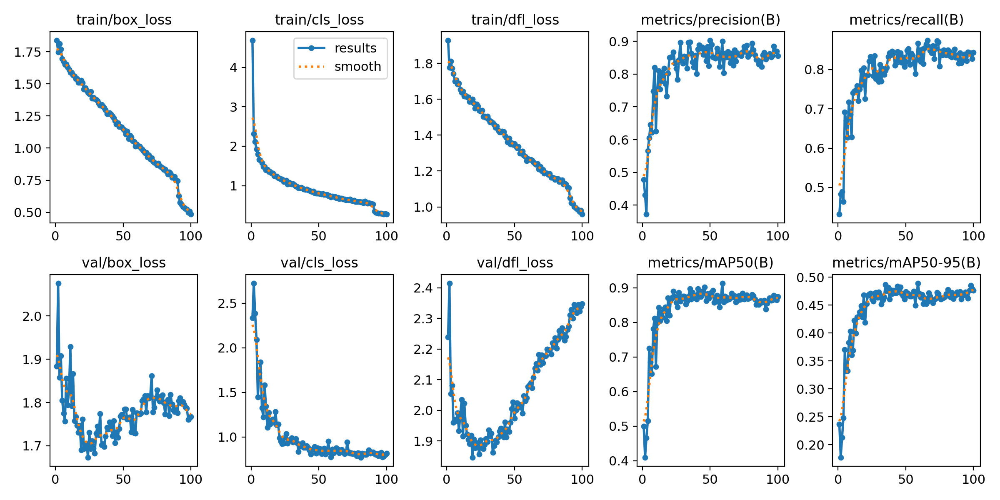

In [7]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/results.png', width=600)

/kaggle/working


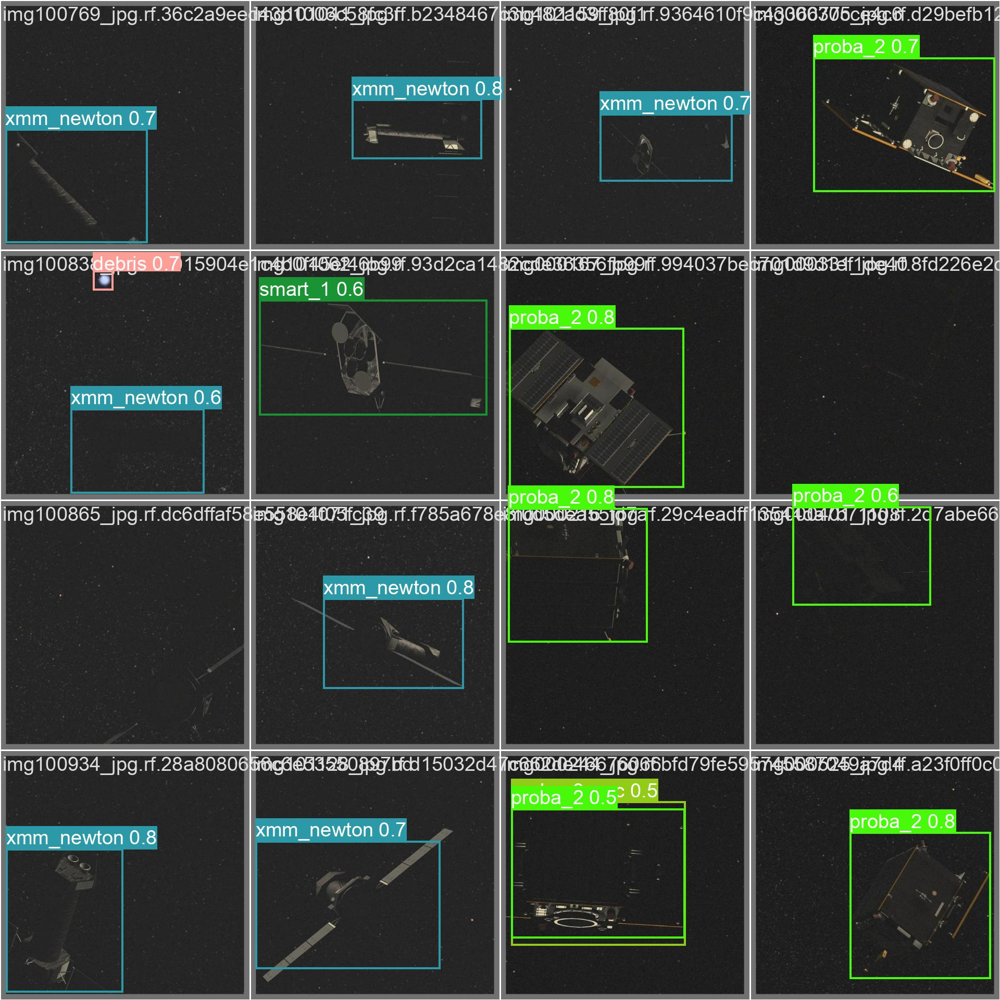

In [8]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

In [9]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.25 source='/kaggle/input/super-new/test/images' save=True

/kaggle/working
Ultralytics YOLOv8.0.196 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11129841 parameters, 0 gradients, 28.5 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/123 /kaggle/input/super-new/test/images/img000124_jpg.rf.dcf525bbc6c6c45a3e387abc33d15112.jpg: 640x640 1 proba_2, 16.4ms
image 2/123 /kaggle/input/super-new/test/images/img000130_jpg.rf.a4d946c704abd619053b1ae42fb3f7c5.jpg: 640x640 (no detections), 16.4ms
image 3/123 /kaggle/input/super-new/test/images/img000154_jpg.rf.fbb21d6523bdbd441fbf6e9747a25862.jpg: 640x640 1 proba_2, 16.3ms
image 4/123 /kaggle/input/super-new/test/images/img000351_jpg.rf.d2125c9fc31022eef818f846607eb45f.jpg: 640x640 1 proba_2, 16.3ms
image 5/123 /kaggle/input/super-new/test/images/img000389_jpg.rf.97dff3fb31ad3cac475a0a257a17c0ee.jpg: 640x640 1 proba_2, 16.3ms
image 6/123 /kaggle/input/super-new/test/images/img000568_jpg.rf.b710221cc166df8b513617a529da988f.jpg: 640x640 (no detections),

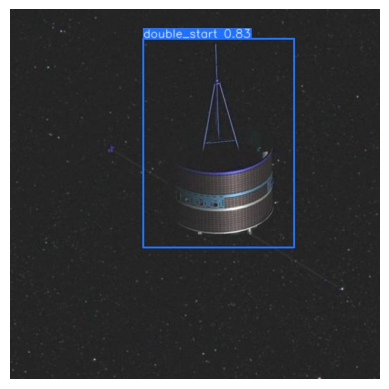

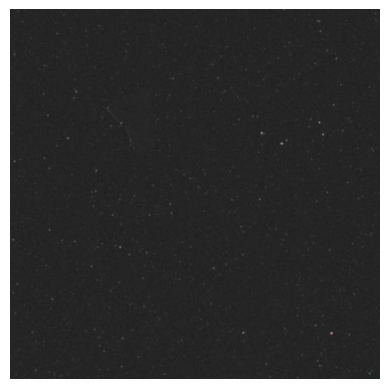

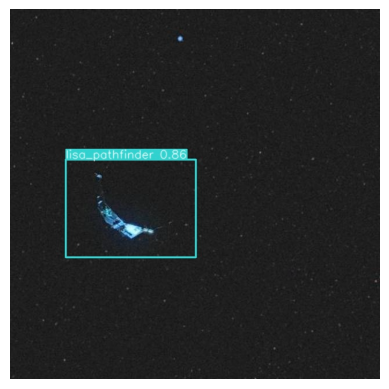

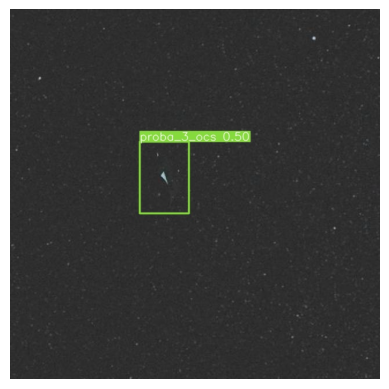

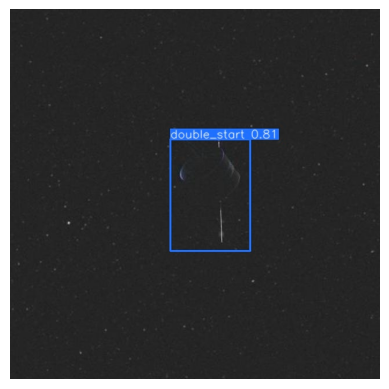

...

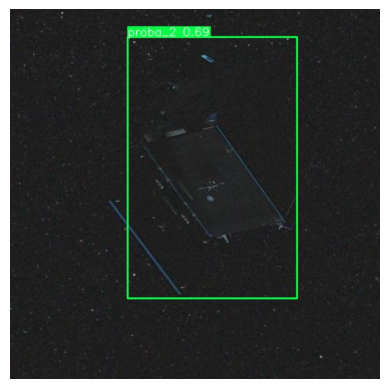

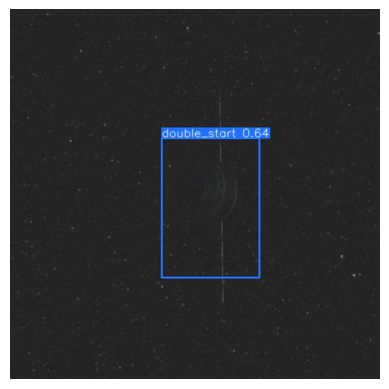

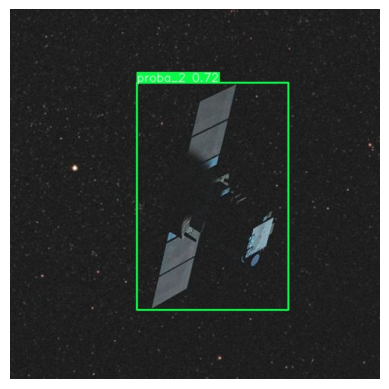

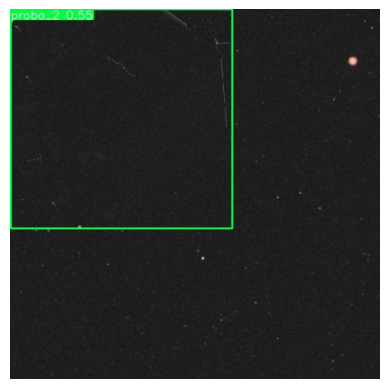

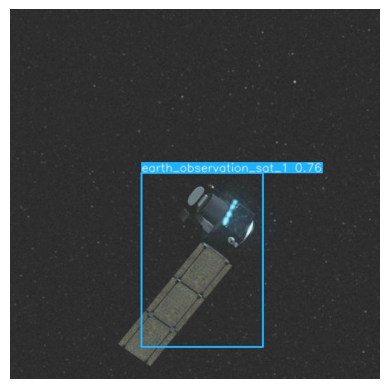

In [12]:
import matplotlib.pyplot as plt
import os
from tqdm import tqdm
import cv2

directory = '/kaggle/working/runs/detect/predict'

for file in os.listdir(directory):
    img = cv2.imread(os.path.join(directory,file))
    
    plt.imshow(img)
    plt.axis('off')
    plt.show()

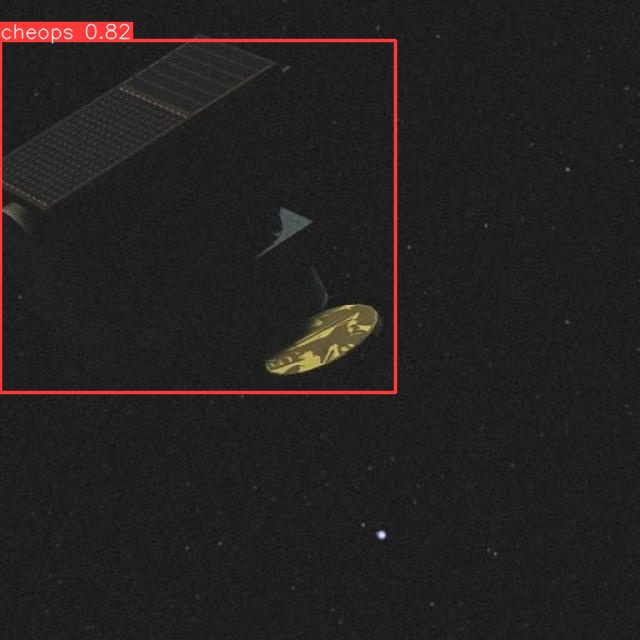

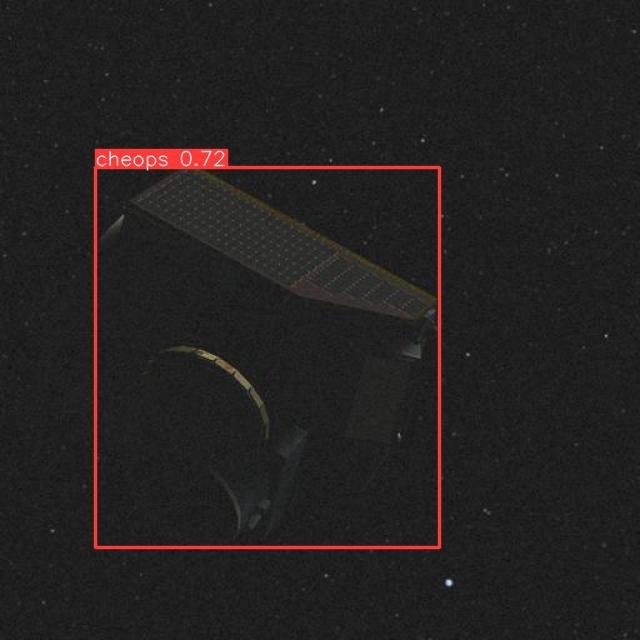

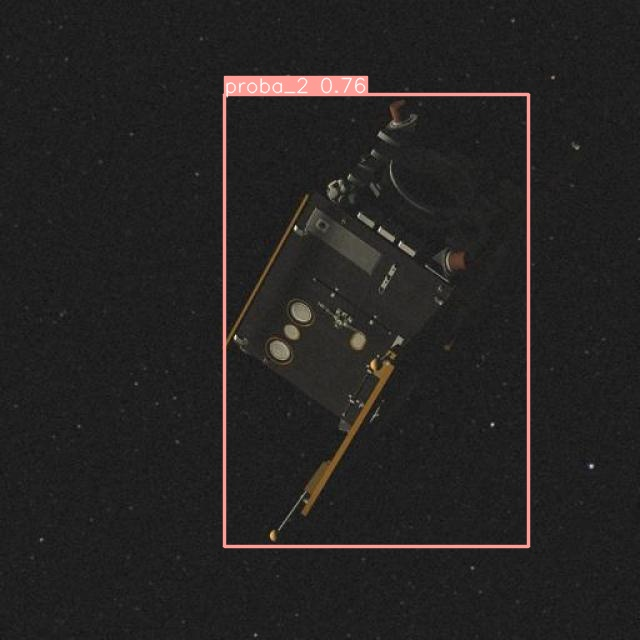

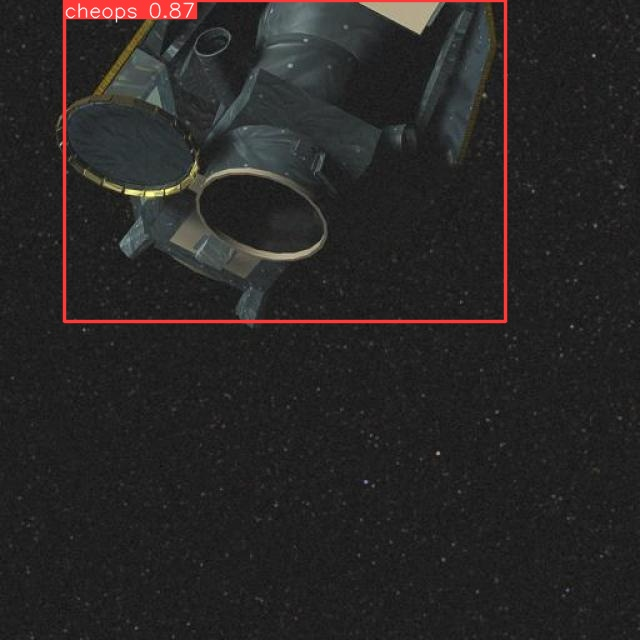

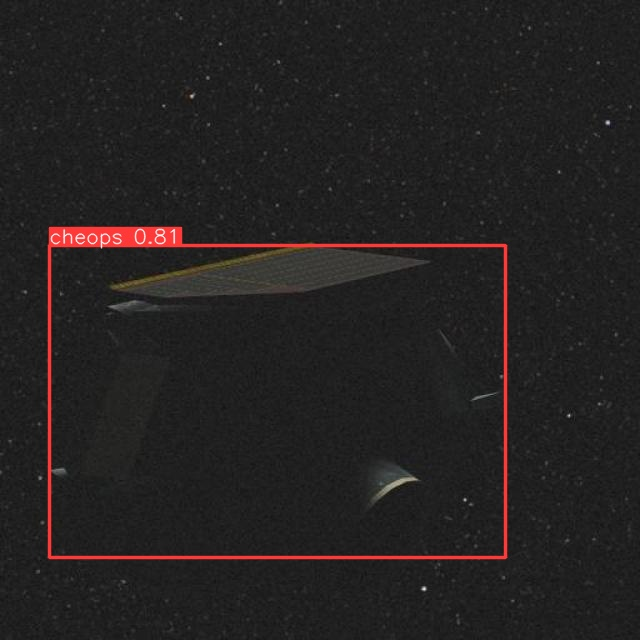

...

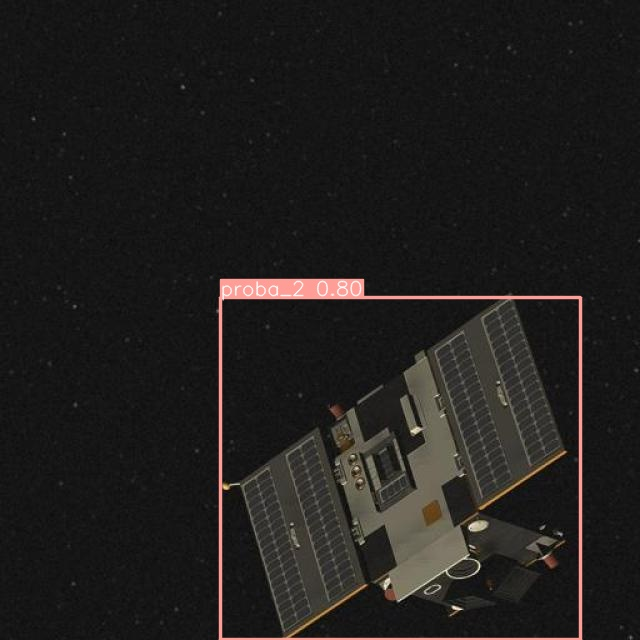

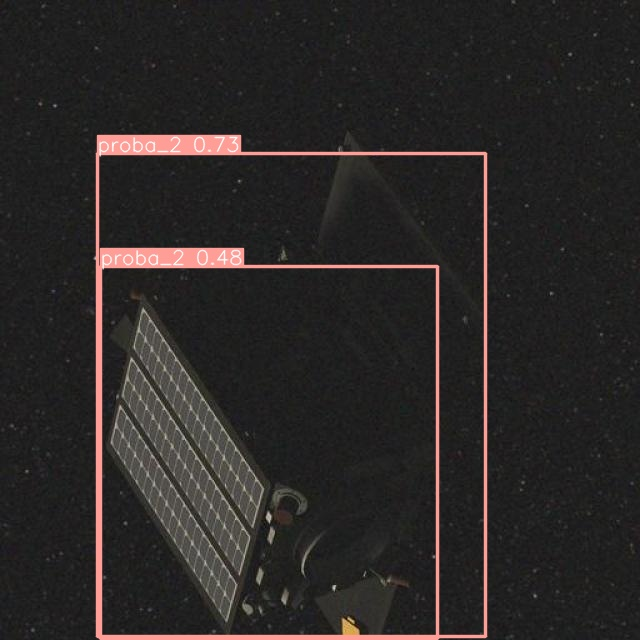

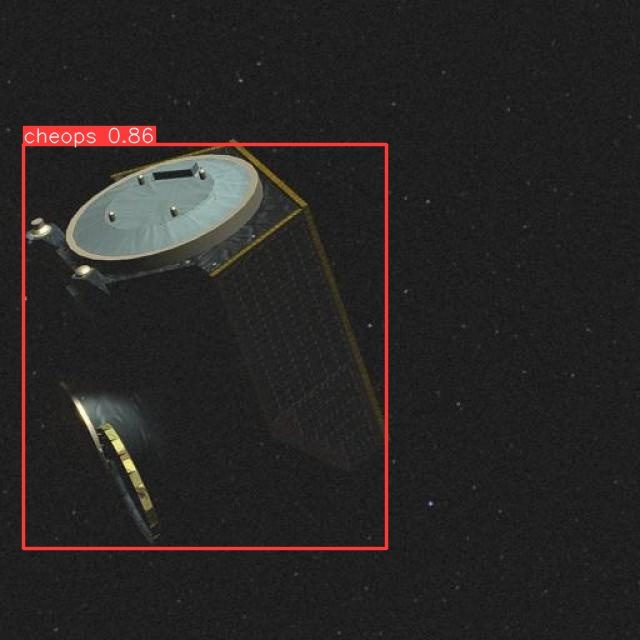

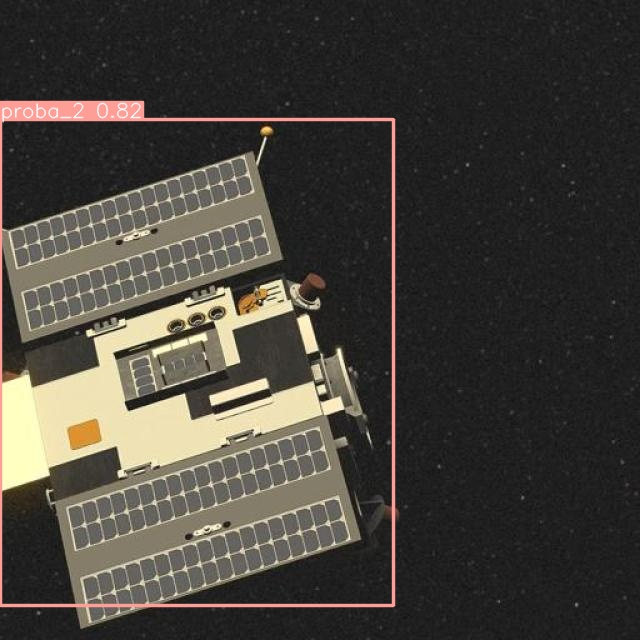

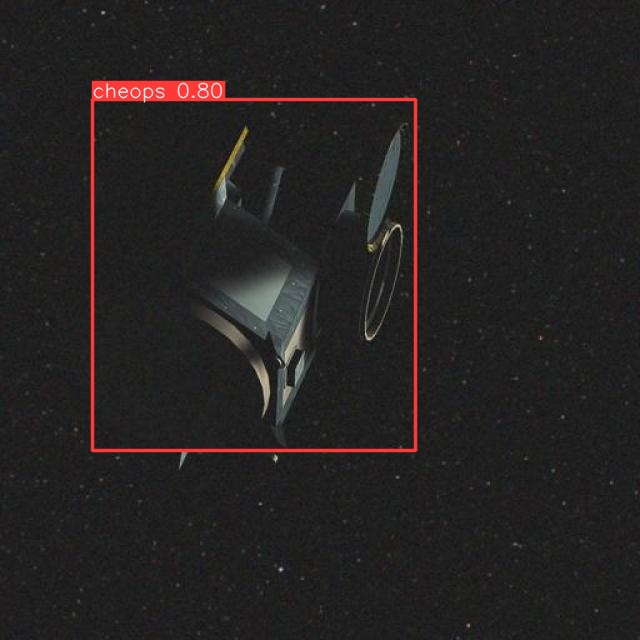

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict/*.jpg'):
      display(Image(filename=image_path, width=600))
      print("\n")

In [13]:
import zipfile
import os
import shutil

def make_zip_of_folder(folder_path, output_zip):
    if not os.path.isdir(folder_path):
        raise ValueError(f"The folder {folder_path} does not exist.")
    shutil.make_archive(output_zip, 'zip', folder_path)
    print(f"Folder '{folder_path}' has been zipped into '{output_zip}.zip'.")

make_zip_of_folder('/kaggle/working/runs', '/kaggle/working/runs_result')


Folder '/kaggle/working/runs' has been zipped into '/kaggle/working/runs_result.zip'.


In [2]:
!pip install gdown

import gdown

file_id = '19Rsj-3ecAer-lPNE5IVxjEHTezWGwDvP'
url = f'https://drive.google.com/uc?id={file_id}'

output = 'file.zip'

gdown.download(url, output, quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=19Rsj-3ecAer-lPNE5IVxjEHTezWGwDvP
From (redirected): https://drive.google.com/uc?id=19Rsj-3ecAer-lPNE5IVxjEHTezWGwDvP&confirm=t&uuid=9d9bec5c-1fa0-4082-b10c-eb4ee17cd136
To: /kaggle/working/file.zip
100%|██████████| 249M/249M [00:08<00:00, 29.3MB/s] 


'file.zip'

In [7]:
import zipfile

def extract_and_delete_zip_file(zip_file_path, extract_to_path):
    
    if not os.path.isfile(zip_file_path):
        raise ValueError(f"The file {zip_file_path} does not exist.")
    
    if not os.path.exists(extract_to_path):
        os.makedirs(extract_to_path)
    
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to_path)
    print(f"Extracted '{zip_file_path}' to '{extract_to_path}'.")

    os.remove(zip_file_path)
    print(f"Deleted zip file '{zip_file_path}'.")

extract_to_path = '/kaggle/working/dataset'

extract_and_delete_zip_file(output, extract_to_path)


Extracted 'file.zip' to '/kaggle/working/dataset'.
Deleted zip file 'file.zip'.


In [19]:
def get_directory_info(directory_path):
    total_size = 0
    num_files = 0

    for dirpath, dirnames, filenames in os.walk(directory_path):
        for file in filenames:
            file_path = os.path.join(dirpath, file)
            total_size += os.path.getsize(file_path)
            num_files += 1

    return num_files, total_size

def convert_size(size_bytes):
    if size_bytes == 0:
        return "0B"
    size_name = ("B", "KB", "MB", "GB", "TB")
    i = int(math.floor(math.log(size_bytes, 1024)))
    p = math.pow(1024, i)
    s = round(size_bytes / p, 2)
    return f"{s} {size_name[i]}"

In [23]:
num_files, total_size = get_directory_info('/kaggle/working/dataset/dataset/images/train')
print(f"Number of files in training: {num_files}")
print(f"Total size: {convert_size(total_size)}")

num_files, total_size = get_directory_info('/kaggle/working/dataset/dataset/images/val')
print(f"Number of files in validation: {num_files}")
print(f"Total size: {convert_size(total_size)}")

Number of files in training: 9900
Total size: 218.69 MB
Number of files in validation: 1100
Total size: 24.24 MB
